In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.animation import PillowWriter
from mpl_toolkits import mplot3d
from IPython.display import Image

In [252]:
def label_to_works(label):
    if label == 1:
        return "Working", "Working"
    elif label == 2:
        return "Working", "Requesting"
    elif label == 3:
        return "Working", "Preparing"
    elif label == 4:
        return "Requesting", "Working"
    elif label == 5:
        return "Requesting", "Requesting"
    elif label == 6:
        return "Requesting", "Preparing"
    elif label == 7:
        return "Preparing", "Working"
    elif label == 8:
        return "Preparing", "Requesting"
    elif label == 9:
        return "Preparing", "Preparing"

In [144]:
def works_to_label(label_1, label_2):
    """
    1 : Working
    2 : Requesting
    3 : Preparing
    """
    if label_1==1 and label_2==1:
        return 1 # Working - Working
    elif label_1==1 and label_2==2:
        return 2 # Working - Requesting
    elif label_1==1 and label_2==3:
        return 3 # Working - Preparing
    elif label_1==2 and label_2==1:
        return 4 # Requesting - Working
    elif label_1==2 and label_2==2:
        return 5 # Requesting - Requesting
    elif label_1==2 and label_2==3:
        return 6 # Requesting - Preparing
    elif label_1==3 and label_2==1:
        return 7 # Preparing - Working
    elif label_1==3 and label_2==2:
        return 8 # Preparing - Requesting
    elif label_1==3 and label_2==3:
        return 9 # Preparing - Preparing

# Choose dataset

In [88]:
import pickle

# grouped
with open("../data/skeleton/final/grouped/grouped_single_skeleton_dict_s01.pkl", "rb") as f:
    skeleton_dict = pickle.load(f)

# paired
# with open("../data/skeleton/final/paired/paired_window_skeleton_dict.pkl", "rb") as f:
#     skeleton_dict = pickle.load(f)

# with open("../data/skeleton/final/paired/paired_window_label_dict.pkl", "rb") as f:
#     label_dict = pickle.load(f)

In [89]:
for k in skeleton_dict.keys():
    print(k)

s01_s02_a01_a01_2_skeleton
s01_s02_a01_a01_3_skeleton
s01_s02_a01_a01_4_skeleton
s01_s02_a01_a01_5_skeleton
s01_s02_a01_a01_6_skeleton
s01_s02_a01_a01_7_skeleton
s01_s02_a01_a02_2_skeleton
s01_s02_a01_a02_3_skeleton
s01_s02_a01_a02_4_skeleton
s01_s02_a01_a02_5_skeleton
s01_s02_a01_a02_6_skeleton
s01_s02_a01_a02_7_skeleton
s01_s02_a01_a03_2_skeleton
s01_s02_a01_a03_3_skeleton
s01_s02_a01_a03_4_skeleton
s01_s02_a01_a03_5_skeleton
s01_s02_a01_a03_6_skeleton
s01_s02_a01_a03_7_skeleton
s01_s03_a01_a01_2_skeleton
s01_s03_a01_a01_3_skeleton
s01_s03_a01_a01_4_skeleton
s01_s03_a01_a01_5_skeleton
s01_s03_a01_a01_6_skeleton
s01_s03_a01_a01_7_skeleton
s01_s03_a01_a02_2_skeleton
s01_s03_a01_a02_3_skeleton
s01_s03_a01_a02_4_skeleton
s01_s03_a01_a02_5_skeleton
s01_s03_a01_a02_6_skeleton
s01_s03_a01_a02_7_skeleton
s01_s03_a01_a03_2_skeleton
s01_s03_a01_a03_3_skeleton
s01_s03_a01_a03_4_skeleton
s01_s03_a01_a03_5_skeleton
s01_s03_a01_a03_6_skeleton
s01_s03_a01_a03_7_skeleton
s01_s04_a01_a01_2_skeleton
s

In [248]:
# choose one file

skeleton_file = "s01_s11_a03_a01_12_skeleton"
label = works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]])
skeletons = np.array(skeleton_dict[skeleton_file])

# paired
label_file = "test_pairs_s3_s2_r1_p2_1_label"
# labels = np.array(label_dict[label_file])

# Plot Image

In [254]:
# Creating 3D figure
def plot_skeleton(skeleton, label):
    fig = plt.figure(figsize = (8,8))
    ax = plt.axes(projection='3d')

    for i in range(10):
        ax.scatter(skeleton[0][i], skeleton[2][i], skeleton[1][i], c='r')

    for i, j in [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]:
        ax.plot([skeleton[0][i], skeleton[0][j]], [skeleton[2][i], skeleton[2][j]], [skeleton[1][i], skeleton[1][j]], c='r')
    ax.set_xlabel("x")
    ax.set_ylabel("z")
    ax.set_zlabel("y")
    ax.set_xlim([0.3, 0.8])
    ax.set_ylim([0.3, 0.8])
    ax.set_zlim([0.3, 0.8])
    ax.invert_zaxis()
    plt.title(label)
    plt.show()

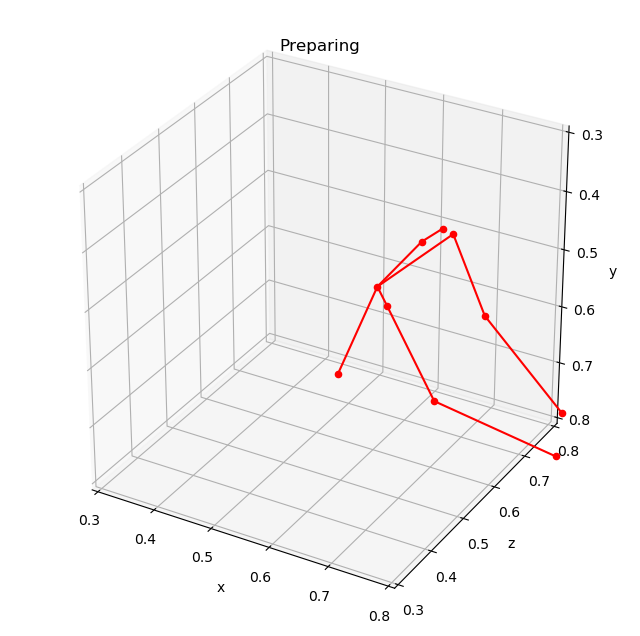

In [256]:
plot_skeleton(skeletons[0][60], label_to_works(label)[0])

# Plot animation of one skeleoton

In [257]:
def animate_skeleton(skeletons, label):

    def update(frame):
        ax.clear()
        ax.set_xlabel("x")
        ax.set_ylabel("z")
        ax.set_zlabel("y")
        ax.set_xlim([0.3, 0.8])
        ax.set_ylim([0.3, 0.8])
        ax.set_zlim([0.3, 0.8])
        ax.invert_zaxis()
        ax.set_title(label)
        
        for i in range(10):
            ax.scatter(skeletons[frame][0][i], skeletons[frame][2][i], skeletons[frame][1][i], c='r')

        for i, j in [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]:
            ax.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                    [skeletons[frame][2][i], skeletons[frame][2][j]], 
                    [skeletons[frame][1][i], skeletons[frame][1][j]], c='r')

    # Set up the figure and axes
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Set the number of frames
    num_frames = skeletons.shape[0]

    # Create the animation
    ani = FuncAnimation(fig, update, frames=num_frames, interval=100)
    plt.close(fig)

    # Save gif
    writer = PillowWriter(fps=30)
    ani.save("one_skeleton.gif", writer=writer)

    # display gif
    return Image(open('one_skeleton.gif', 'rb').read())

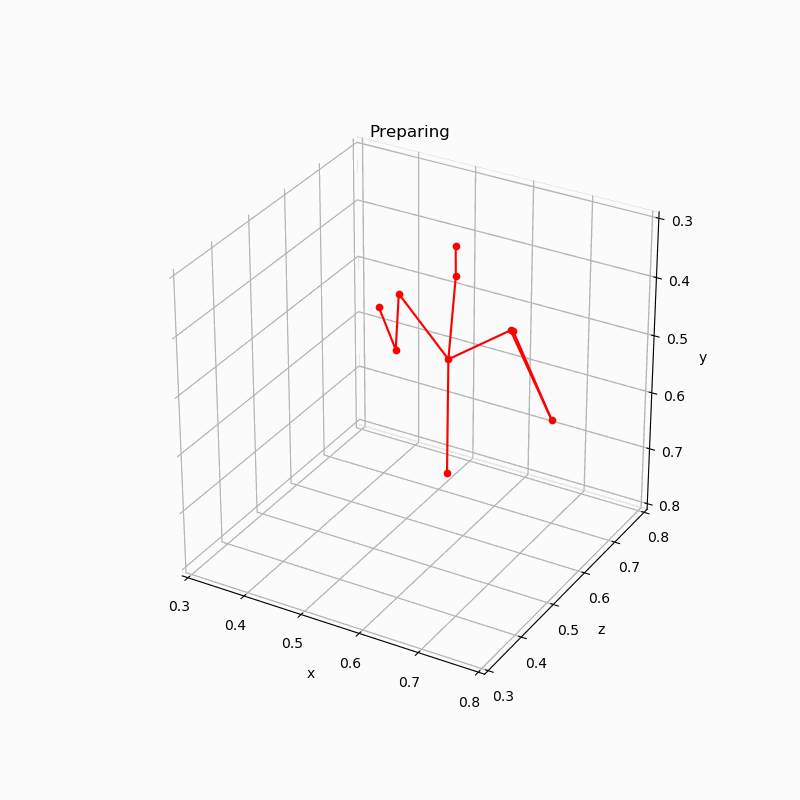

In [258]:
animate_skeleton(skeletons[0], label_to_works(label)[0])

# Plot animation of two skeletons

In [269]:
def animate_skeletons(skeletons, label, subplot=True):

    # have stop function in video
    # plt.rcParams["animation.html"] = "jshtml"
    # plt.rcParams['figure.dpi'] = 100  
    # plt.ioff()

    def update(frame):
        ax.clear()
        ax.set_xlabel("x")
        ax.set_ylabel("z")
        ax.set_zlabel("y")
        ax.set_xlim([0.3, 0.8])
        ax.set_ylim([0.3, 0.8])
        ax.set_zlim([0.3, 0.8])
        ax.invert_zaxis()
        if subplot:
            ax2.clear()
            ax2.set_xlabel("x")
            ax2.set_ylabel("z")
            ax2.set_zlabel("y")
            ax2.set_xlim([0.3, 0.8])
            ax2.set_ylim([0.3, 0.8])
            ax2.set_zlim([0.3, 0.8])
            ax2.invert_zaxis()
            ax.set_title(label1)
            ax2.set_title(label2)
        else:
            ax.set_title(label)
        
        for i in range(10):
            ax.scatter(skeletons[frame][0][i], skeletons[frame][2][i], skeletons[frame][1][i], c='r')

            if subplot:
                ax2.scatter(skeletons[frame][0][i+10], skeletons[frame][2][i+10], skeletons[frame][1][i+10], c='b')
            else:
                ax.scatter(skeletons[frame][0][i+10], skeletons[frame][2][i+10], skeletons[frame][1][i+10], c='b')

        for i, j in [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]:
            ax.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                    [skeletons[frame][2][i], skeletons[frame][2][j]], 
                    [skeletons[frame][1][i], skeletons[frame][1][j]], 'r')
            
        for i, j in [[10,11], [11,12], [11,13], [13,14], [14,15], [11,16], [16,17], [17,18], [12,19]]:
            if subplot:
                ax2.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                        [skeletons[frame][2][i], skeletons[frame][2][j]], 
                        [skeletons[frame][1][i], skeletons[frame][1][j]], 'b')
            else:
                ax.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                        [skeletons[frame][2][i], skeletons[frame][2][j]], 
                        [skeletons[frame][1][i], skeletons[frame][1][j]], 'b')

    # Set up the figure and axes
    if subplot:
        fig = plt.figure(figsize=(8, 5))
        ax = fig.add_subplot(121, projection='3d')
        ax2 = fig.add_subplot(122, projection='3d')
        label1, label2 = label
    else:
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(111, projection='3d')
        label = " (red) - ".join(label) + " (blue)"
    
    # Set the number of frames
    num_frames = skeletons.shape[0]

    # Create the animation
    ani = FuncAnimation(fig, update, frames=num_frames, interval=100)
    plt.close(fig)

    # Save gif
    writer = PillowWriter(fps=30)
    ani.save("two_skeletons.gif", writer=writer)

    # display gif
    return Image(open('./two_skeletons.gif', 'rb').read())

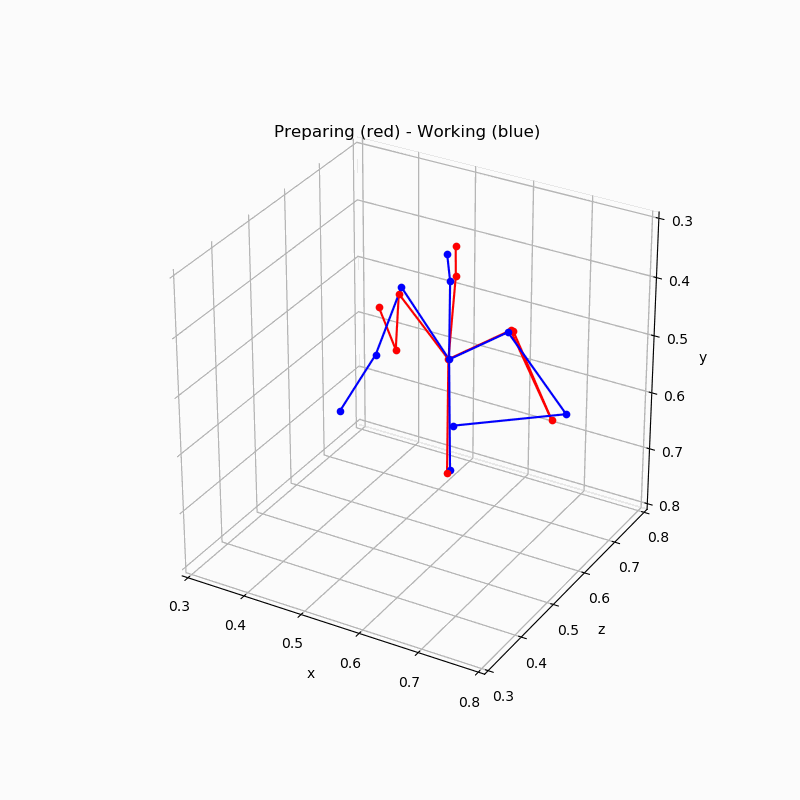

In [270]:
animate_skeletons(skeletons[1], label_to_works(label), subplot=False)

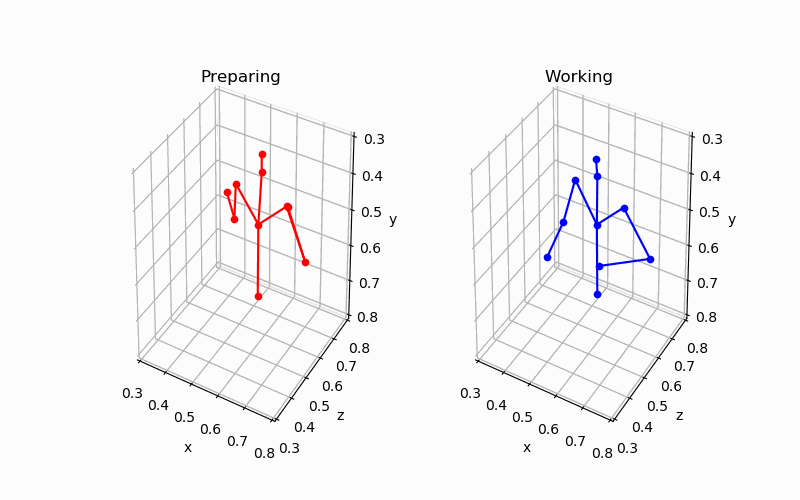

In [260]:
# without overlapping
animate_skeletons(skeletons[1], label_to_works(label), subplot=True)

# Show all animations of works(working, requesting, preparing)

In [221]:
# working skeleton
skeleton_file = "s01_s11_a01_a02_12_skeleton"
label1 = label_to_works(works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]]))[0]
skeleton1 = np.array(skeleton_dict[skeleton_file])[0][:, :, :10]

# requesting skeleton
skeleton_file = "s01_s11_a02_a02_12_skeleton"
label2 = label_to_works(works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]]))[0]
skeleton2 = np.array(skeleton_dict[skeleton_file])[0][:, :, :10]

# preparing skeleton
skeleton_file = "s01_s11_a03_a02_12_skeleton"
label3 = label_to_works(works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]]))[0]
skeleton3 = np.array(skeleton_dict[skeleton_file])[0][:, :, :10]

In [273]:
def animate_three_skeletons(skeletons, labels):

    def update(frame):
        for i in range(3):
            if i == 0:
                ax = ax1
                label = labels[0]
                skeleton = skeletons[0]
            elif i == 1:
                ax = ax2
                label = labels[1]
                skeleton = skeletons[1]
            elif i == 2:
                ax = ax3
                label = labels[2]
                skeleton = skeletons[2]

            ax.clear()
            ax.set_xlabel("x")
            ax.set_ylabel("z")
            ax.set_zlabel("y")
            ax.set_xlim([0.3, 0.8])
            ax.set_ylim([0.3, 0.8])
            ax.set_zlim([0.3, 0.8])
            ax.invert_zaxis()
            ax.set_title(label)
            
            for i in range(10):
                ax.scatter(skeleton[frame][0][i], skeleton[frame][2][i], skeleton[frame][1][i], c='r')

            for i, j in [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]:
                ax.plot([skeleton[frame][0][i], skeleton[frame][0][j]], 
                        [skeleton[frame][2][i], skeleton[frame][2][j]], 
                        [skeleton[frame][1][i], skeleton[frame][1][j]], c='r')

    # Set up the figure and axes
    fig = plt.figure(figsize=(14, 5))
    ax1 = fig.add_subplot(131, projection='3d')
    ax2 = fig.add_subplot(132, projection='3d')
    ax3 = fig.add_subplot(133, projection='3d')

    # Set the number of frames
    num_frames = skeletons[0].shape[0]

    # Create the animation
    ani = FuncAnimation(fig, update, frames=num_frames, interval=100)
    plt.close(fig)

    # Save gif
    writer = PillowWriter(fps=30)
    ani.save("three_skeletons.gif", writer=writer)

    # display gif
    return Image(open('three_skeletons.gif', 'rb').read())

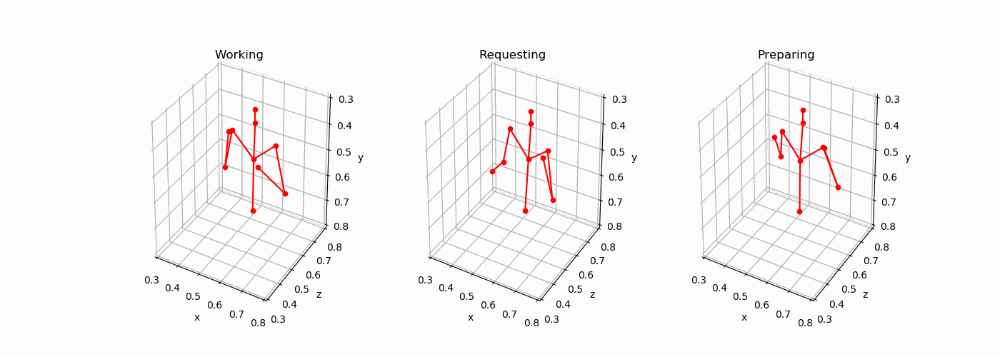

In [274]:
animate_three_skeletons([skeleton1, skeleton2, skeleton3], [label1, label2, label3])